In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
from astropy.utils import data
from astropy.io import fits  # We use fits to open the actual data file
from casatasks import simobserve, tclean, exportfits

def load_fits(inFile):
    hdu_list = fits.open(inFile)
    data = hdu_list[0].data
    hdu_list.close()
    return data

In [ ]:

filename = 'cgauss_001.fits'
project = 'sim'
antennalist = "alma.cycle9.3.cfg"
simobserve(
        project=project, 
        skymodel=filename,
        inbright="0.001Jy/pix",
        indirection="J2000 03h59m59.96s -34d59m59.50s",
        incell="0.1arcsec",
        incenter="230GHz",
        inwidth="10MHz",
        setpointings=True,
        integration="10s",
        direction="J2000 03h59m59.96s -34d59m59.50s",
        mapsize=["10arcsec"],
        maptype="hexagonal",
        obsmode="int",
        antennalist=antennalist,
        totaltime="2400s",
        thermalnoise="tsys-atm",
        user_pwv=0.8,
        seed=11111,
        graphics="none",
        verbose=False,
        overwrite=True)
        

In [ ]:
exportfits(imagename=project+'/{}.alma.cycle9.3.skymodel'.format(project), 
           fitsimage="gauss_skymodel.fits", overwrite=True)

clean = load_fits('gauss_skymodel.fits')[0]
plt.imshow(clean[0], origin='lower', cmap='magma')

In [ ]:
tclean(
        vis=os.path.join(project, "{}.alma.cycle9.3.noisy.ms".format(project)),
        imagename=project+'/{}.alma.cycle9.3'.format(project),
        imsize=[300, 300],
        cell=["0.1arcsec"],
        phasecenter="",
        specmode="cube",
        niter=0,
        fastnoise=False,
        calcpsf=True,
        pbcor=False
        )


In [ ]:
exportfits(imagename=project+'/{}.alma.cycle9.3.image'.format(project), 
           fitsimage="dirty_gauss.fits", overwrite=True)

In [ ]:


dirty = load_fits('dirty_gauss.fits')[0]
clean = load_fits('gauss_skymodel.fits')[0]
original = load_fits('cgauss_001.fits')[0]
print(dirty.shape, clean.shape, original.shape)


fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].imshow(dirty[0, :, :], origin='lower', cmap='viridis')
ax[1].imshow(clean[0, :, :], origin='lower', cmap='viridis')
ax[2].imshow(original[0, :, :], origin='lower', cmap='viridis')



In [ ]:
skymodel = load_fits('gauss_001.fits')
print(skymodel.shape)
csky = skymodel[512 - 150: 512 + 150, 512 - 150: 512 + 150][np.newaxis, np.newaxis]
print(csky.shape)
hdu = fits.PrimaryHDU(data=csky.astype(np.float32))
hdu.writeto('cgauss_001.fits', overwrite=True)

In [ ]:
skymodel = load_fits('cgauss_001.fits')
skymodel.shape
plt.imshow(skymodel[0, 0, :, :], origin='lower', cmap='viridis')

In [ ]:
from casatasks import exportuvfits
exportuvfits(vis=os.path.join(project, "{}.alma.cycle9.3.noisy.ms".format(project)),
                fitsfile="gauss_uvfits.fits", datacolumn="data", overwrite=True)

In [3]:
uvf = load_fits('gauss_uvfits.fits')
print(uvf.shape)

(216720,)


In [4]:
from pyuvdata import UVData
UV = UVData()
UV.read_uvfits('gauss_uvfits.fits')
data = UV.get_data(1, 2, 'xx')
print(data.shape)

(240, 1)


In [3]:
ants = UV.get_ants()
print(ants)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43]


In [5]:
UV.set_uvws_from_antenna_positions(allow_phasing=True)
uwvs = UV.uvw_array
print(uwvs.shape)


(216720, 3)


In [ ]:
UV.sum_vis()

In [11]:
import plotly.express as px
import pandas as pd
df = pd.DataFrame(uwvs, columns=['u','v','w'])
fig = px.scatter_3d(df, x='u', y='v', z='w', width=800, height=800, size=3 * np.ones(len(df)))
fig.show()

In [16]:
visibilities = UV.data_array
print(visibilities.shape)
print(visibilities[:100, 0, 0, 0])

(216720, 1, 1, 2)
[ 2.1274567 -9.39411163e-01j  0.09676702+4.77842899e-04j
  0.2295881 -2.93888841e-02j  0.15201119+1.02209166e-01j
  0.37540594-2.14130834e-01j  0.26722407+5.96365556e-02j
  0.11134146-2.60967791e-01j  0.09310833+1.07213572e-01j
  0.394993  -1.90260187e-01j -0.34345078+1.01417519e-01j
 -0.2402736 -4.57228124e-01j  0.22889481+1.26305029e-01j
  0.27196407+1.37995303e-01j  0.00389109-6.36030659e-02j
 -0.20173089-5.98375686e-02j  2.951619  -1.48163521e+00j
  0.31655505-3.53185505e-01j -0.19397892-7.99860507e-02j
  0.110937  +2.35315621e-01j  0.09948632+1.49822477e-02j
  0.07034732-5.12528658e-01j -0.30986866-5.83004989e-02j
  0.2572358 +2.10785151e-01j -0.03719466-4.25962001e-01j
 -0.05227889-2.76105076e-01j -0.05361455-1.37427077e-01j
  0.48680085+1.55427858e-01j -0.1866063 -3.07722181e-01j
 -0.2179887 -1.66192874e-01j -0.06024266+1.18328303e-01j
  0.02167051-1.11419320e-01j  0.02003893-9.01276991e-02j
 -0.05453406+9.01650339e-02j -0.0783095 +3.22302639e-01j
  0.06122875+

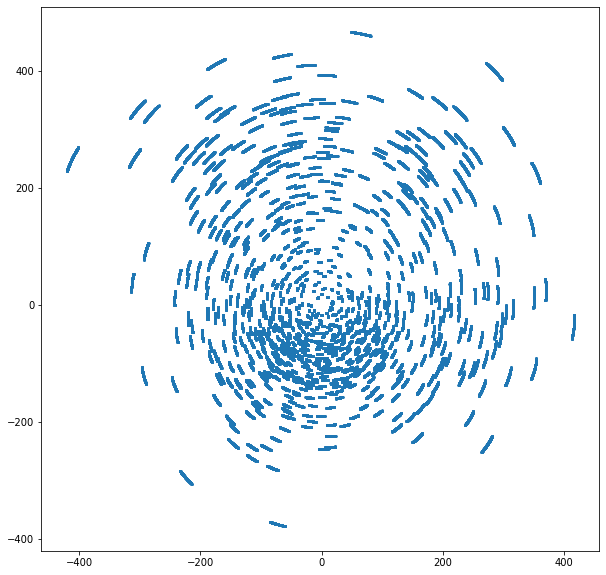

In [13]:
plt.figure(figsize=(10, 10))
plt.scatter(uwvs[:, 0], uwvs[:, 1], s=3)
plt.show()

In [18]:
project = 'sim'
UV.read_ms(os.path.join(project, "{}.alma.cycle9.3.noisy.ms".format(project)))

ImportError: casacore is not installed but is required for measurement set functionality